<a href="https://colab.research.google.com/github/MeghanRN/PinnaNet/blob/main/PinnaNET.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip -q install numpy scipy soundfile librosa torch tqdm pysofaconventions netCDF4

import os, random, requests
import numpy as np
from tqdm import tqdm
from scipy.signal import fftconvolve

import librosa
import soundfile as sf

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader

import pysofaconventions as pysofa
import matplotlib.pyplot as plt

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

# Reproducibility
SEED = 0
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
if torch.cuda.is_available():
    torch.cuda.manual_seed_all(SEED)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.2/89.2 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.1/10.1 MB 57.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 37.1 MB/s eta 0:00:00
Device: cuda


In [ ]:
from google.colab import files
files.upload()

Saving HRTF_Sphere_ICO_40000.sofa to HRTF_Sphere_ICO_40000.sofa


{'HRTF_Sphere_ICO_40000.sofa': b'\x89HDF\r\n\x1a\n\x02\x08\x08\x00\x00\x00\x00\x00\x00\x00\x00\x00\xff\xff\xff\xff\xff\xff\xff\xff]\xebm\x00\x00\x00\x00\x000\x00\x00\x00\x00\x00\x00\x00\xd6\xf9\x19\x1cOHDR\x02\r4\x02\x02"\x00\x00\x00\x00\x00\x03\x10\x00\x00\x00\x00\x00\x00\x00\x137\x00\x00\x00\x00\x00\x00\xa57\x00\x00\x00\x00\x00\x00\xcb7\x00\x00\x00\x00\x00\x00\n\x02\x00\x01\x00\x00\x00\x00\x15\x1c\x00\x04\x00\x00\x00\x03\x17\x00p\x02\x00\x00\x00\x00\x00\x00\x02\x03\x00\x00\x00\x00\x00\x00(\x03\x00\x00\x00\x00\x00\x00\x00\xdc\x01\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x06\x14\x00\x00\x07\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x06\x14\x00\x00\x07\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x06\x14\x00\x00\x07\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x06\x14\x00\x00\x07\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00

In [ ]:
# ============================================================
# 1. Use uploaded SOFA file
# ============================================================

sofa_path = "/content/HRTF_Sphere_ICO_40000.sofa"

print("Using SOFA file:", sofa_path)


✅ Using SOFA file: /content/HRTF_Sphere_ICO_40000.sofa


In [ ]:
# ============================================================
# 2. Load SOFA and extract HRIRs + source angles (TF -> IR)
# ============================================================

import numpy as np
import netCDF4 as nc

# --- Open as NetCDF directly (robust for TF SOFAs) ---
ds = nc.Dataset(sofa_path, "r")

# SourcePosition: (M, 3) = [az_deg, el_deg, radius]
pos = np.array(ds.variables["SourcePosition"][:], dtype=np.float32)
az_all = pos[:, 0].astype(np.float32)
el_all = pos[:, 1].astype(np.float32)

# TF data: (M, R, N) where R=2 ears, N=freq bins (often without DC)
real = np.array(ds.variables["Data.Real"][:], dtype=np.float32)  # (M,2,N)
imag = np.array(ds.variables["Data.Imag"][:], dtype=np.float32)  # (M,2,N)
H = real + 1j * imag                                             # complex TF

# Frequency vector (Hz). In your file it's stored in variable "N".
freqs = np.array(ds.variables["N"][:], dtype=np.float32)          # (N,)

# Infer sample rate from Nyquist if not provided: sr ≈ 2*max(freq)
# Your file goes to 20000 Hz => sr=40000 Hz.
sr = int(round(2.0 * float(freqs.max())))

# Infer FFT size from frequency spacing (assumes uniform spacing)
df = float(freqs[1] - freqs[0])
NFFT_TF = int(round(sr / df))  # e.g., 40000/100 = 400

# Real FFT expects NFFT/2 + 1 bins including DC and Nyquist
expected_bins = NFFT_TF // 2 + 1

print("SOFA file :", sofa_path)
print("DataType  :", getattr(ds, "DataType", "Unknown"))
print("TF shape  :", H.shape, " (M, R, N)")
print("freq bins :", freqs.shape, f"[{freqs.min():.1f} .. {freqs.max():.1f}] Hz, df={df:.1f} Hz")
print("Inferred  :", f"sr={sr} Hz, NFFT_TF={NFFT_TF}, expected rfft bins={expected_bins}")
print("#dirs     :", H.shape[0])
print("Azimuth   :", float(az_all.min()), "…", float(az_all.max()), "deg")
print("Elevation :", float(el_all.min()), "…", float(el_all.max()), "deg")

# --- If TF bins omit DC (common), prepend a DC bin ---
# Your file: N=200 bins from 100..20000, missing 0 Hz => add DC to make 201 bins.
if H.shape[-1] == expected_bins - 1:
    H0 = H[..., :1]                 # copy the first bin (100 Hz) as a DC proxy
    H = np.concatenate([H0, H], axis=-1)
elif H.shape[-1] != expected_bins:
    raise RuntimeError(
        f"Unexpected TF bin count: got {H.shape[-1]}, expected {expected_bins} "
        f"(or {expected_bins-1} if DC is missing)."
    )

# --- Convert TF -> HRIR via irfft over frequency bins ---
# Result: (M, R, taps)
ir = np.fft.irfft(H, n=NFFT_TF, axis=-1).astype(np.float32)

# Reformat to match your pipeline expectation: (M, taps, 2)
IR = np.transpose(ir, (0, 2, 1))  # (M, taps, R)

print("HRIR IR shape:", IR.shape, "(M, taps, 2)")


SOFA file : /content/HRTF_Sphere_ICO_40000.sofa
DataType  : TF
TF shape  : (2562, 2, 200)  (M, R, N)
freq bins : (200,) [100.0 .. 20000.0] Hz, df=100.0 Hz
Inferred  : sr=40000 Hz, NFFT_TF=400, expected rfft bins=201
#dirs     : 2562
Azimuth   : 0.0 … 359.99993896484375 deg
Elevation : -89.99995422363281 … 89.99995422363281 deg
HRIR IR shape: (2562, 400, 2) (M, taps, 2)


In [ ]:
# ============================================================
# 3. Utility functions: audio, random sources, features (mag+phase)
# ============================================================

MAX_TAPS = 512    # truncate HRIR for speed (optional)
MELS     = 64
NFFT     = 1024
HOP      = 256
T_TARGET = 256    # target # of frames in spectrogram

# Truncate HRIR taps if needed (IR is assumed (Ndirs, taps, 2))
if MAX_TAPS is not None and IR.shape[1] > MAX_TAPS:
    IR = IR[:, :MAX_TAPS, :]
    print("Truncated IR to", IR.shape[1], "taps")

def rms(x: np.ndarray) -> float:
    x = np.asarray(x, dtype=np.float32)
    return float(np.sqrt(np.mean(x * x) + 1e-12))

def mono_normalize(x: np.ndarray, target_db: float = -20.0) -> np.ndarray:
    """
    Normalize mono signal to a given RMS level in dBFS-like units.
    Also applies peak protection to avoid clipping.
    """
    x = np.asarray(x, dtype=np.float32)
    x_rms = rms(x)
    if x_rms < 1e-10:
        return x

    target_lin = 10.0 ** (target_db / 20.0)
    gain = target_lin / x_rms
    y = x * gain

    peak = float(np.max(np.abs(y)) + 1e-12)
    if peak > 0.999:
        y = y / peak

    return y.astype(np.float32)

def convolve_mono(x: np.ndarray, h: np.ndarray) -> np.ndarray:
    """
    Convolve mono signal x with mono kernel h.
    Returns output truncated to len(x) for convenience.
    """
    x = np.asarray(x, dtype=np.float32)
    h = np.asarray(h, dtype=np.float32)

    if MAX_TAPS is not None and h.shape[0] > MAX_TAPS:
        h = h[:MAX_TAPS]

    y = fftconvolve(x, h, mode="full").astype(np.float32)
    return y[: x.shape[0]]

# ---- Random source generators -----------------------------------------------

def make_white_noise(seconds: float = 6.0, sr: int = None) -> np.ndarray:
    if sr is None:
        raise ValueError("sr must be provided (use the SOFA sampling rate).")
    n = int(seconds * sr)
    x = np.random.randn(n).astype(np.float32)
    x /= (np.max(np.abs(x)) + 1e-8)
    return x

def make_pinkish_noise(seconds: float = 6.0, sr: int = None, alpha: float = None) -> np.ndarray:
    """
    Approximate 1/f^alpha noise.
      alpha ~ 1   -> pink-ish
      alpha ~ 0   -> white
      alpha < 0   -> blue-ish
    If alpha is None, samples alpha uniformly in [-0.5, 1.0].
    """
    if sr is None:
        raise ValueError("sr must be provided (use the SOFA sampling rate).")
    if alpha is None:
        alpha = float(np.random.uniform(-0.5, 1.0))

    n = int(seconds * sr)
    x = np.random.randn(n).astype(np.float32)

    N = 1 << (n - 1).bit_length()
    X = np.fft.rfft(x, n=N)
    freqs = np.fft.rfftfreq(N, 1.0 / sr).astype(np.float32)
    freqs[0] = freqs[1]  # avoid divide by zero

    # power ~ 1 / f^alpha  ->  amplitude ~ 1 / f^(alpha/2)
    X *= 1.0 / (np.maximum(freqs, 20.0) ** (alpha / 2.0))

    y = np.fft.irfft(X, n=N).astype(np.float32)[:n]
    y /= (np.max(np.abs(y)) + 1e-8)
    return y

def make_band_limited_noise(seconds: float = 6.0, sr: int = None) -> np.ndarray:
    """
    Random band-limited noise: choose random center + bandwidth
    and apply a Gaussian envelope in frequency.
    """
    if sr is None:
        raise ValueError("sr must be provided (use the SOFA sampling rate).")
    n = int(seconds * sr)
    x = np.random.randn(n).astype(np.float32)

    N = 1 << (n - 1).bit_length()
    X = np.fft.rfft(x, n=N)
    freqs = np.fft.rfftfreq(N, 1.0 / sr).astype(np.float32)

    f_center = float(np.random.uniform(500.0, min(12000.0, 0.45 * sr)))
    f_bw     = float(np.random.uniform(1000.0, min(8000.0, 0.40 * sr)))
    sigma = f_bw / 2.0

    env = np.exp(-0.5 * ((freqs - f_center) / (sigma + 1e-8)) ** 2).astype(np.float32)
    X *= env

    y = np.fft.irfft(X, n=N).astype(np.float32)[:n]
    y /= (np.max(np.abs(y)) + 1e-8)
    return y

def make_random_source(seconds: float = 6.0, sr: int = None) -> np.ndarray:
    """
    Randomly choose a source type to improve robustness.
    """
    if sr is None:
        raise ValueError("sr must be provided (use the SOFA sampling rate).")
    choice = np.random.choice(["white", "pinkish", "band"])
    if choice == "white":
        return make_white_noise(seconds, sr)
    elif choice == "pinkish":
        return make_pinkish_noise(seconds, sr)
    else:
        return make_band_limited_noise(seconds, sr)

# ---- Augmentation ------------------------------------------------------------

def augment_mono(x: np.ndarray, snr_db: float = 30.0, gain_jitter_db: float = 3.0) -> np.ndarray:
    """
    Simple time-domain augmentation for training:
      - gain jitter (±gain_jitter_db)
      - additive white noise at ~snr_db SNR
    """
    x = np.asarray(x, dtype=np.float32)

    # Gain jitter
    g_db = float(np.random.uniform(-gain_jitter_db, gain_jitter_db))
    g = 10.0 ** (g_db / 20.0)
    y = x * g

    # Additive noise at target SNR
    noise = np.random.randn(*y.shape).astype(np.float32)
    y_rms = rms(y)
    n_rms = rms(noise)
    if y_rms > 0 and n_rms > 0:
        snr_lin = 10.0 ** (snr_db / 20.0)
        noise *= (y_rms / (snr_lin * n_rms))

    return (y + noise).astype(np.float32)

# ---- Mel filters for magnitude + phase features -----------------------------

mel_filters = librosa.filters.mel(
    sr=sr, n_fft=NFFT, n_mels=MELS, fmin=20.0, fmax=sr / 2.0
)  # (MELS, NFFT//2+1)

def _pad_or_crop_time(feat: np.ndarray, T_target: int = T_TARGET) -> np.ndarray:
    """
    feat: (C, F, T)
    Return feat with T == T_target via right zero-padding or truncation.
    """
    C, F, T = feat.shape
    if T < T_target:
        feat = np.pad(feat, ((0, 0), (0, 0), (0, T_target - T)), mode="constant")
    elif T > T_target:
        feat = feat[:, :, :T_target]
    return feat

def make_features_single_ear(wave: np.ndarray, sr: int) -> np.ndarray:
    """
    wave: mono float32 signal
    Returns (4, MELS, T_TARGET):
      0 = log-mel magnitude
      1 = delta log-mel
      2 = cos(phase in mel bands)
      3 = sin(phase in mel bands)
    """
    wave = np.asarray(wave, dtype=np.float32)

    S = librosa.stft(
        wave,
        n_fft=NFFT,
        hop_length=HOP,
        win_length=NFFT,
        window="hann",
        center=True,
        pad_mode="reflect",
    )  # (F, T)

    # Complex mel projection
    S_mel = mel_filters @ S  # (MELS, T)

    mag_mel = np.abs(S_mel) + 1e-10
    phase_mel = np.angle(S_mel)

    logmel = np.log10(mag_mel).astype(np.float32)
    delta_logmel = librosa.feature.delta(logmel, mode="nearest").astype(np.float32)

    cos_phase = np.cos(phase_mel).astype(np.float32)
    sin_phase = np.sin(phase_mel).astype(np.float32)

    feat = np.stack([logmel, delta_logmel, cos_phase, sin_phase], axis=0)  # (4, MELS, T)
    feat = _pad_or_crop_time(feat, T_target=T_TARGET)

    return feat.astype(np.float32)


In [ ]:
# ============================================================
# 4. Build TRAIN + VAL datasets (single-ear, random sources, mag+phase)
#    - For each direction:
#        * TRAIN: K_TRAIN random sources (with augmentation)
#        * VAL  : K_VAL   random sources (no augmentation)
# ============================================================

K_TRAIN = 2  # per direction
K_VAL   = 1  # per direction

SECONDS = 6.0
TARGET_DB = -20.0

X_tr_list, Y_tr_list = [], []
X_va_list, Y_va_list = [], []

n_dirs = IR.shape[0]
print("Building dataset from #dirs =", n_dirs)

for i in tqdm(range(n_dirs), desc="Synth+Feature (train/val, single ear, mag+phase)"):
    # LEFT EAR ONLY (IR is assumed (Ndirs, taps, 2))
    hL = IR[i, :, 0].astype(np.float32)

    az_i = float(az_all[i])
    el_i = float(el_all[i])

    # ---- TRAIN examples ----
    for _ in range(K_TRAIN):
        src = make_random_source(seconds=SECONDS, sr=sr)
        yL  = convolve_mono(src, hL)
        yL  = mono_normalize(yL, TARGET_DB)
        yL  = augment_mono(yL)  # training-only augmentation

        feat = make_features_single_ear(yL, sr)  # (4, MELS, T_TARGET)
        X_tr_list.append(feat)
        Y_tr_list.append([az_i, el_i])

    # ---- VAL examples (no augmentation) ----
    for _ in range(K_VAL):
        src = make_random_source(seconds=SECONDS, sr=sr)
        yL  = convolve_mono(src, hL)
        yL  = mono_normalize(yL, TARGET_DB)

        feat = make_features_single_ear(yL, sr)
        X_va_list.append(feat)
        Y_va_list.append([az_i, el_i])

# Stack into arrays
Xtr = np.stack(X_tr_list, axis=0).astype(np.float32)  # (N_tr, 4, MELS, T_TARGET)
Ytr = np.asarray(Y_tr_list, dtype=np.float32)         # (N_tr, 2)

Xva = np.stack(X_va_list, axis=0).astype(np.float32)  # (N_va, 4, MELS, T_TARGET)
Yva = np.asarray(Y_va_list, dtype=np.float32)         # (N_va, 2)

print("\nTRAIN dataset:")
print("  Xtr:", Xtr.shape, "Ytr:", Ytr.shape)
print("VAL dataset:")
print("  Xva:", Xva.shape, "Yva:", Yva.shape)

# Quick sanity checks
print("\nSanity checks:")
print("  az range:", float(np.min(Ytr[:, 0])), "…", float(np.max(Ytr[:, 0])))
print("  el range:", float(np.min(Ytr[:, 1])), "…", float(np.max(Ytr[:, 1])))
print("  feature dtype:", Xtr.dtype, " label dtype:", Ytr.dtype)


Building dataset from #dirs = 2562


Synth+Feature (train/val, single ear, mag+phase): 100%|██████████| 2562/2562 [08:34<00:00,  4.98it/s]



TRAIN dataset:
  Xtr: (5124, 4, 64, 256) Ytr: (5124, 2)
VAL dataset:
  Xva: (2562, 4, 64, 256) Yva: (2562, 2)

Sanity checks:
  az range: 0.0 … 359.99993896484375
  el range: -89.99995422363281 … 89.99995422363281
  feature dtype: float32  label dtype: float32


In [ ]:
# ============================================================
# 5. Angular utilities: circular + great-circle + vec<->angles
# ============================================================

import numpy as np
import torch

def circ_err_deg(pred_deg: np.ndarray, true_deg: np.ndarray) -> np.ndarray:
    """
    Smallest signed difference between angles in degrees (wrap-aware).
    Works elementwise for any shape.
    Output range: [-180, 180)
    """
    pred_deg = np.asarray(pred_deg, dtype=np.float32)
    true_deg = np.asarray(true_deg, dtype=np.float32)
    return ((pred_deg - true_deg + 180.0) % 360.0) - 180.0

def circ_mae_deg_np(pred_deg: np.ndarray, true_deg: np.ndarray):
    """
    Circular MAE for angles in degrees.
    pred_deg, true_deg: (N,2) where columns are [azimuth, elevation]
    Returns:
      per_component_mae: (2,)  -> [MAE_az, MAE_el]
      overall_mae: scalar (mean over both components)
    """
    pred_deg = np.asarray(pred_deg, dtype=np.float32)
    true_deg = np.asarray(true_deg, dtype=np.float32)

    diff = np.abs(circ_err_deg(pred_deg, true_deg))
    per_comp = diff.mean(axis=0)
    avg = float(diff.mean())
    return per_comp, avg

def sph_to_vec_deg(az_deg, el_deg) -> np.ndarray:
    """
    Convert (azimuth, elevation) in degrees to 3D unit vectors.
    az_deg, el_deg: broadcastable arrays
    Returns: (..., 3)
    """
    az = np.deg2rad(np.asarray(az_deg, dtype=np.float32))
    el = np.deg2rad(np.asarray(el_deg, dtype=np.float32))

    x = np.cos(el) * np.cos(az)
    y = np.cos(el) * np.sin(az)
    z = np.sin(el)
    return np.stack([x, y, z], axis=-1).astype(np.float32)

def vec_to_sph_deg(v: np.ndarray) -> np.ndarray:
    """
    Convert 3D unit vectors v (N,3) to (azimuth_deg, elevation_deg).
    Returns azimuth in [0, 360), elevation in [-90, 90].
    """
    v = np.asarray(v, dtype=np.float32)
    if v.ndim != 2 or v.shape[1] != 3:
        raise ValueError(f"v must be (N,3), got shape={v.shape}")

    x, y, z = v[:, 0], v[:, 1], v[:, 2]
    az = np.rad2deg(np.arctan2(y, x)).astype(np.float32)
    el = np.rad2deg(np.arcsin(np.clip(z, -1.0, 1.0))).astype(np.float32)

    az = np.mod(az, 360.0).astype(np.float32)
    return np.stack([az, el], axis=-1).astype(np.float32)

def great_circle_err_deg(pred_deg: np.ndarray, true_deg: np.ndarray) -> np.ndarray:
    """
    Great-circle angular error (degrees) per sample.
    pred_deg, true_deg: (N,2) arrays of [az, el] in degrees.
    Returns: (N,) array of angular distances in degrees.
    """
    pred_deg = np.asarray(pred_deg, dtype=np.float32)
    true_deg = np.asarray(true_deg, dtype=np.float32)

    vp = sph_to_vec_deg(pred_deg[:, 0], pred_deg[:, 1])
    vg = sph_to_vec_deg(true_deg[:, 0], true_deg[:, 1])

    dot = np.sum(vp * vg, axis=1)
    dot = np.clip(dot, -1.0, 1.0)
    ang = np.arccos(dot)  # radians
    return np.rad2deg(ang).astype(np.float32)

def great_circle_mae_deg(pred_deg: np.ndarray, true_deg: np.ndarray) -> float:
    """Mean great-circle error (degrees)."""
    return float(np.mean(great_circle_err_deg(pred_deg, true_deg)))

# ---------------- Torch helpers (training) ----------------

def sph_to_vec_torch(az_deg: torch.Tensor, el_deg: torch.Tensor) -> torch.Tensor:
    """
    Convert (B,) az/el in degrees to (B,3) unit vectors (torch).
    """
    az = torch.deg2rad(az_deg)
    el = torch.deg2rad(el_deg)

    x = torch.cos(el) * torch.cos(az)
    y = torch.cos(el) * torch.sin(az)
    z = torch.sin(el)
    return torch.stack([x, y, z], dim=-1)

def cosine_loss(pred_vec: torch.Tensor, true_vec: torch.Tensor) -> torch.Tensor:
    """
    Vector-based loss: 1 - cos(angle), averaged over batch.
    pred_vec and true_vec should be (B,3) and ideally normalized.
    """
    dot = (pred_vec * true_vec).sum(dim=-1).clamp(-1.0, 1.0)
    return (1.0 - dot).mean()


In [ ]:
# ============================================================
# 6. PinnaNet: biologically-inspired vector CNN (single-ear)
#      - Anisotropic convs (freq > time) to catch spectral notches
#      - Global pooling over time (direction ≈ time-invariant)
#      - 1D conv over frequency + squeeze-excite channel attention
#      - Outputs 3D unit vector direction
# ============================================================

import torch
import torch.nn as nn
import torch.nn.functional as F

class ConvBlock(nn.Module):
    """
    Two Conv2d layers with BatchNorm + ReLU and optional 2x2 MaxPool.
    Uses anisotropic kernels (freq x time) to emphasize spectral patterns.
    """
    def __init__(self, in_ch: int, out_ch: int, kernel_size=(7, 3), pool: bool = True):
        super().__init__()
        kf, kt = kernel_size
        pad = (kf // 2, kt // 2)

        self.conv1 = nn.Conv2d(in_ch, out_ch, kernel_size=kernel_size, padding=pad, bias=False)
        self.bn1   = nn.BatchNorm2d(out_ch)
        self.conv2 = nn.Conv2d(out_ch, out_ch, kernel_size=kernel_size, padding=pad, bias=False)
        self.bn2   = nn.BatchNorm2d(out_ch)

        self.act   = nn.ReLU(inplace=True)
        self.pool  = nn.MaxPool2d(2) if pool else nn.Identity()

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        x = self.act(self.bn1(self.conv1(x)))
        x = self.act(self.bn2(self.conv2(x)))
        x = self.pool(x)
        return x

class SqueezeExcite(nn.Module):
    """
    Squeeze-and-Excitation on channels for (B, C, F).
    Learns a channel-wise gate based on frequency-averaged activations.
    """
    def __init__(self, channels: int, reduction: int = 8):
        super().__init__()
        hidden = max(channels // reduction, 4)
        self.fc1 = nn.Linear(channels, hidden)
        self.fc2 = nn.Linear(hidden, channels)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # x: (B, C, F)
        s = x.mean(dim=2)                 # (B, C)
        s = F.relu(self.fc1(s), inplace=True)
        s = torch.sigmoid(self.fc2(s))    # (B, C)
        return x * s.unsqueeze(-1)        # (B, C, 1) broadcast over F

class PinnaNet(nn.Module):
    """
    Pinna-inspired CNN for single-ear localization.
    Input : (B, C_in, F, T)
    Output: (B, 3) unit vectors on the sphere.
    """
    def __init__(self, in_ch: int):
        super().__init__()

        # 2D conv tower over (freq, time), freq-heavy kernels
        self.block1 = ConvBlock(in_ch,  32, kernel_size=(7, 3), pool=True)
        self.block2 = ConvBlock(32,     64, kernel_size=(7, 3), pool=True)
        self.block3 = ConvBlock(64,    128, kernel_size=(5, 3), pool=True)
        self.block4 = ConvBlock(128,   128, kernel_size=(3, 3), pool=False)

        # After conv blocks:
        # 1) average over time -> (B, 128, F')
        # 2) 1D conv over frequency to learn notch/peak patterns
        self.freq_conv = nn.Conv1d(128, 128, kernel_size=5, padding=2, bias=False)
        self.freq_bn   = nn.BatchNorm1d(128)
        self.freq_act  = nn.ReLU(inplace=True)

        # Channel attention
        self.se = SqueezeExcite(128, reduction=8)

        # Global pool over frequency -> (B, 128)
        self.global_pool = nn.AdaptiveAvgPool1d(1)

        # Head -> 3D vector, then normalize to unit length
        self.head = nn.Linear(128, 3)

    def forward(self, x: torch.Tensor) -> torch.Tensor:
        # x: (B, C_in, F, T)
        z = self.block1(x)
        z = self.block2(z)
        z = self.block3(z)
        z = self.block4(z)                # (B, 128, F', T')

        # Average over time axis
        z = z.mean(dim=-1)                # (B, 128, F')

        # Frequency conv
        z = self.freq_conv(z)
        z = self.freq_bn(z)
        z = self.freq_act(z)

        # Squeeze-excite
        z = self.se(z)

        # Global pool over frequency
        z = self.global_pool(z).squeeze(-1)   # (B, 128)

        # Predict and normalize
        v = self.head(z)                      # (B, 3)
        v = v / (v.norm(dim=-1, keepdim=True) + 1e-8)
        return v


In [ ]:
# ============================================================
# 7. Dataloaders + PinnaNet init
# ============================================================

# ---- Torch datasets ----
Xtr_t = torch.from_numpy(Xtr).float()
Ytr_t = torch.from_numpy(Ytr).float()

Xva_t = torch.from_numpy(Xva).float()
Yva_t = torch.from_numpy(Yva).float()

ds_tr = TensorDataset(Xtr_t, Ytr_t)
ds_va = TensorDataset(Xva_t, Yva_t)

# ---- Loaders ----
BATCH_TRAIN = 32
BATCH_VAL   = 64

dl_tr = DataLoader(ds_tr, batch_size=BATCH_TRAIN, shuffle=True,  drop_last=True)
dl_va = DataLoader(ds_va, batch_size=BATCH_VAL,   shuffle=False, drop_last=False)

print("Train size:", len(ds_tr), " Val size:", len(ds_va))

# ---- Model / optimizer ----
in_ch = Xtr.shape[1]  # channels in feature tensor (C_in)
print("PinnaNet in_ch =", in_ch)

model = PinnaNet(in_ch=in_ch).to(device)
opt   = optim.Adam(model.parameters(), lr=1e-3)
print("Model on:", device)


Train size: 5124  Val size: 2562
PinnaNet in_ch = 4
Model on: cuda


In [ ]:
# ============================================================
# 8. Training loop (vector outputs + cosine loss, single-ear, mag+phase)
# ============================================================

EPOCHS = 25
LOG_EVERY = 1  # print every N epochs

# Use a dataset-agnostic checkpoint name (don’t hardcode P0001)
ckpt_path = "/content/work/model_single_ear_vec_randomsrc_phase.pt"
os.makedirs(os.path.dirname(ckpt_path), exist_ok=True)

best = {
    "val_gc_mae": 1e9,
    "epoch": 0,
    "circ_per_comp": None,
    "circ_avg": None,
}

for ep in range(1, EPOCHS + 1):
    # -------------------- TRAIN --------------------
    model.train()
    running_loss = 0.0
    n_seen = 0

    for xb, yb in dl_tr:
        xb = xb.to(device, non_blocking=True)   # (B, C, F, T)
        yb = yb.to(device, non_blocking=True)   # (B, 2) [az, el] in deg

        opt.zero_grad(set_to_none=True)

        pred_vec = model(xb)  # (B, 3)
        true_vec = sph_to_vec_torch(yb[:, 0], yb[:, 1]).to(device)  # (B, 3)

        loss = cosine_loss(pred_vec, true_vec)
        loss.backward()
        opt.step()

        bs = xb.size(0)
        running_loss += float(loss.item()) * bs
        n_seen += bs

    tr_loss = running_loss / max(n_seen, 1)

    # -------------------- VAL --------------------
    model.eval()
    preds_vec = []
    gts_deg   = []

    with torch.no_grad():
        for xb, yb in dl_va:
            xb = xb.to(device, non_blocking=True)
            v  = model(xb).detach().cpu().numpy()   # (B, 3)
            preds_vec.append(v)
            gts_deg.append(yb.numpy())              # (B, 2)

    P_vec = np.concatenate(preds_vec, axis=0)  # (N_val, 3)
    G_deg = np.concatenate(gts_deg, axis=0)    # (N_val, 2)
    P_deg = vec_to_sph_deg(P_vec)              # (N_val, 2)

    per_comp_circ, avg_circ = circ_mae_deg_np(P_deg, G_deg)
    gc_mae = great_circle_mae_deg(P_deg, G_deg)

    if ep % LOG_EVERY == 0:
        print(
            f"Epoch {ep:04d} | train_loss={tr_loss:.4f} | "
            f"circ_MAE θ={per_comp_circ[0]:5.2f}°, φ={per_comp_circ[1]:5.2f}° (avg {avg_circ:5.2f}°) | "
            f"GC_MAE={gc_mae:5.2f}°"
        )

    # -------------------- CHECKPOINT BEST --------------------
    if gc_mae < best["val_gc_mae"]:
        best = {
            "val_gc_mae": float(gc_mae),
            "epoch": int(ep),
            "circ_per_comp": [float(per_comp_circ[0]), float(per_comp_circ[1])],
            "circ_avg": float(avg_circ),
        }
        torch.save(
            {
                "model": model.state_dict(),
                "epoch": ep,
                "best": best,
                "sr": sr,
                "MELS": MELS,
                "NFFT": NFFT,
                "HOP": HOP,
                "T_TARGET": T_TARGET,
            },
            ckpt_path,
        )

print("\nBest result (by great-circle MAE):")
print(best)
print("Saved best checkpoint to:", ckpt_path)


Epoch 0001 | train_loss=0.1172 | circ_MAE θ=38.44°, φ=22.86° (avg 30.65°) | GC_MAE=38.40°
Epoch 0002 | train_loss=0.1063 | circ_MAE θ=28.53°, φ=16.90° (avg 22.72°) | GC_MAE=26.61°
Epoch 0003 | train_loss=0.0994 | circ_MAE θ=24.25°, φ=14.00° (avg 19.12°) | GC_MAE=23.23°
Epoch 0004 | train_loss=0.0818 | circ_MAE θ=34.56°, φ=48.98° (avg 41.77°) | GC_MAE=55.65°
Epoch 0005 | train_loss=0.0799 | circ_MAE θ=54.23°, φ=35.44° (avg 44.84°) | GC_MAE=55.80°
Epoch 0006 | train_loss=0.1431 | circ_MAE θ=46.27°, φ=19.66° (avg 32.97°) | GC_MAE=40.32°
Epoch 0007 | train_loss=0.0913 | circ_MAE θ=35.39°, φ=15.16° (avg 25.28°) | GC_MAE=30.60°
Epoch 0008 | train_loss=0.0783 | circ_MAE θ=22.83°, φ=15.81° (avg 19.32°) | GC_MAE=25.23°
Epoch 0009 | train_loss=0.0696 | circ_MAE θ=26.52°, φ=14.96° (avg 20.74°) | GC_MAE=25.23°
Epoch 0010 | train_loss=0.0633 | circ_MAE θ=26.50°, φ=14.70° (avg 20.60°) | GC_MAE=25.13°
Epoch 0011 | train_loss=0.0524 | circ_MAE θ=21.54°, φ=14.72° (avg 18.13°) | GC_MAE=22.31°
Epoch 0012

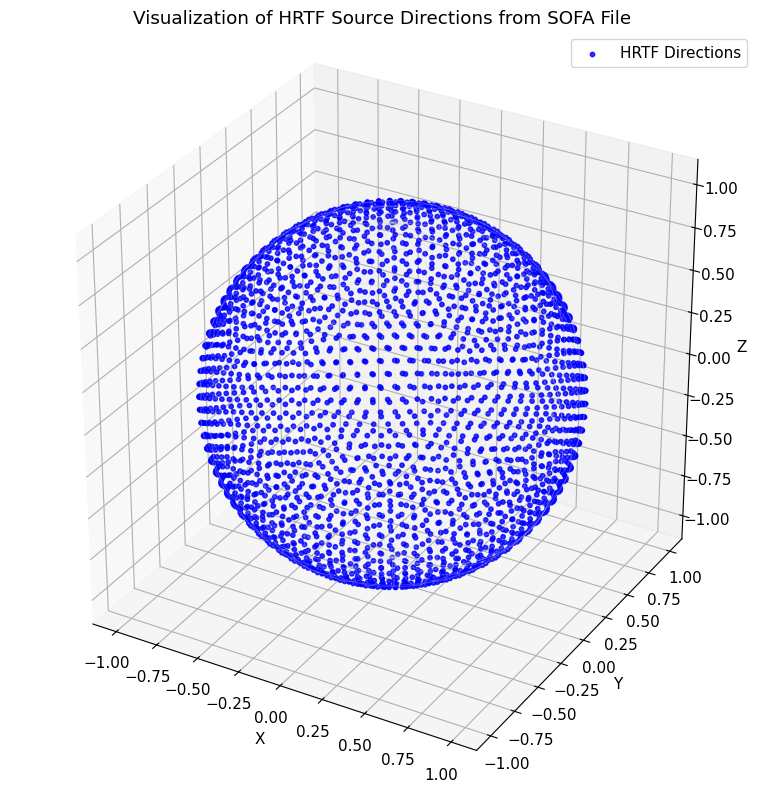

In [ ]:
# I had gemeni create this cell just to vizualize the sofa file and the directions of the hrtf

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Source positions are already loaded as az_all, el_all from cell vn-4YU7PPOvj
# These arrays are (2562,) containing azimuth and elevation in degrees

# Convert spherical coordinates (azimuth, elevation) to 3D Cartesian vectors
V_sofa_dirs = sph_to_vec_deg(az_all, el_all)

fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

# Plot the HRTF directions
ax.scatter(
V_sofa_dirs[:, 0], V_sofa_dirs[:, 1], V_sofa_dirs[:, 2],
s=10, c='blue', alpha=0.8, label='HRTF Directions'
)

# Add a wireframe unit sphere for context
theta = np.linspace(0, 2 * np.pi, 80)
phi   = np.linspace(0, np.pi, 40)
theta, phi = np.meshgrid(theta, phi)

xs = np.sin(phi) * np.cos(theta)
ys = np.sin(phi) * np.sin(theta)
zs = np.cos(phi)

ax.plot_wireframe(
xs, ys, zs,
rstride=3, cstride=3,
color='lightgray', alpha=0.3, linewidth=0.5
)

ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Visualization of HRTF Source Directions from SOFA File')
ax.set_box_aspect([1, 1, 1]) # Equal aspect ratio
ax.legend()
plt.tight_layout()
plt.show()

In [ ]:
# ============================================================
# 9. Load best checkpoint and evaluate on validation set
# ============================================================

# Load checkpoint
state = torch.load(ckpt_path, map_location=device)
model.load_state_dict(state["model"])
model.eval()
print("Loaded best checkpoint from:", ckpt_path)

# Run inference on validation set
P_vec_val = []
with torch.no_grad():
    for xb, _ in dl_va:
        xb = xb.to(device, non_blocking=True)
        v = model(xb).detach().cpu().numpy()   # (B, 3)
        P_vec_val.append(v)

P_vec_val = np.concatenate(P_vec_val, axis=0)  # (N_val, 3)

# Convert predicted vectors -> (az, el) in degrees
P_val = vec_to_sph_deg(P_vec_val)              # (N_val, 2)

# Ground-truth angles (already degrees)
G_val = np.asarray(Yva, dtype=np.float32)      # (N_val, 2)

# Metrics
per_comp_circ, avg_circ = circ_mae_deg_np(P_val, G_val)
gc_mae_full = great_circle_mae_deg(P_val, G_val)

print("\n=== Validation Metrics (single-ear, random sources, mag+phase) ===")
print(f"Circular MAE  az, el (deg): {per_comp_circ[0]:6.2f}°, {per_comp_circ[1]:6.2f}°")
print(f"Circular MAE  avg (deg)   : {avg_circ:6.2f}°")
print(f"Great-circle MAE (deg)    : {gc_mae_full:6.2f}°")


✅ Loaded best checkpoint from: /content/work/model_single_ear_vec_randomsrc_phase.pt

=== Validation Metrics (single-ear, random sources, mag+phase) ===
Circular MAE  az, el (deg):  14.34°,   8.74°
Circular MAE  avg (deg)   :  11.54°
Great-circle MAE (deg)    :  14.67°


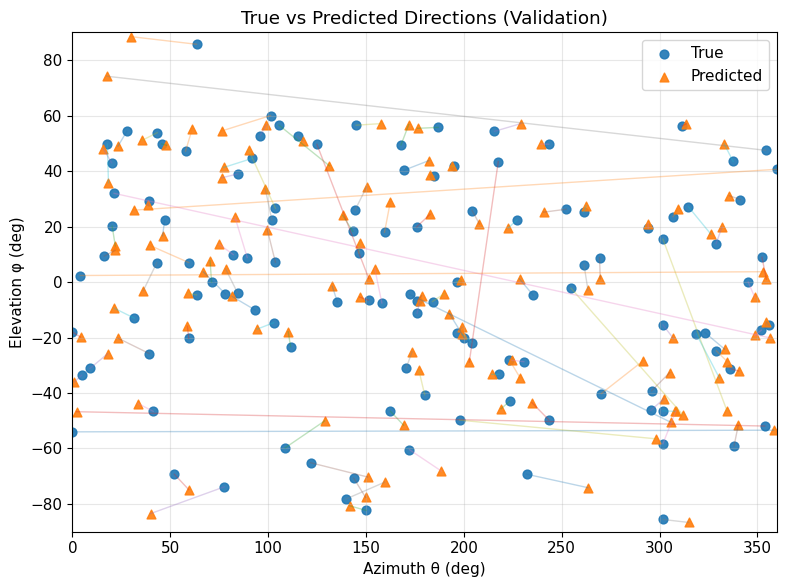

GC error mean   : 14.67°
GC error median : 8.22°
GC error 95th % : 63.45°


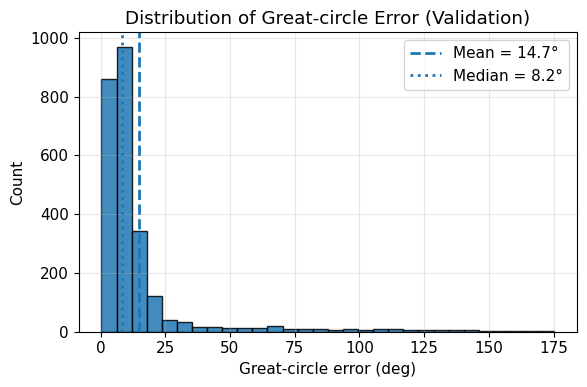

In [ ]:
# ============================================================
# 10. Visual checks: scatter + histogram of great-circle error
# ============================================================

import numpy as np
import matplotlib.pyplot as plt

# ---- Scatter: true vs predicted directions ----
Nplot = min(120, len(G_val))
rng = np.random.default_rng(0)
sel = rng.choice(len(G_val), Nplot, replace=False)

az_true = (G_val[sel, 0] % 360.0).astype(np.float32)
el_true = G_val[sel, 1].astype(np.float32)
az_pred = (P_val[sel, 0] % 360.0).astype(np.float32)
el_pred = P_val[sel, 1].astype(np.float32)

fig, ax = plt.subplots(figsize=(8, 6))
ax.scatter(az_true, el_true, s=40, marker="o", label="True", alpha=0.9)
ax.scatter(az_pred, el_pred, s=40, marker="^", label="Predicted", alpha=0.9)

# Draw connecting lines
for at, et, ap, ep in zip(az_true, el_true, az_pred, el_pred):
    ax.plot([at, ap], [et, ep], alpha=0.3, linewidth=1)

ax.set_xlim(0, 360)
ax.set_ylim(-90, 90)
ax.set_xlabel("Azimuth θ (deg)")
ax.set_ylabel("Elevation φ (deg)")
ax.set_title("True vs Predicted Directions (Validation)")
ax.grid(alpha=0.3)
ax.legend()
plt.tight_layout()
plt.show()

# ---- Histogram: great-circle errors ----
gc_err = great_circle_err_deg(P_val, G_val).astype(np.float32)

gc_mean = float(np.mean(gc_err))
gc_median = float(np.median(gc_err))
gc_p95 = float(np.percentile(gc_err, 95))

print(f"GC error mean   : {gc_mean:.2f}°")
print(f"GC error median : {gc_median:.2f}°")
print(f"GC error 95th % : {gc_p95:.2f}°")

plt.figure(figsize=(6, 4))
plt.hist(gc_err, bins=30, edgecolor="black", alpha=0.85)
plt.axvline(gc_mean, linestyle="--", linewidth=2, label=f"Mean = {gc_mean:.1f}°")
plt.axvline(gc_median, linestyle=":", linewidth=2, label=f"Median = {gc_median:.1f}°")
plt.xlabel("Great-circle error (deg)")
plt.ylabel("Count")
plt.title("Distribution of Great-circle Error (Validation)")
plt.grid(alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()


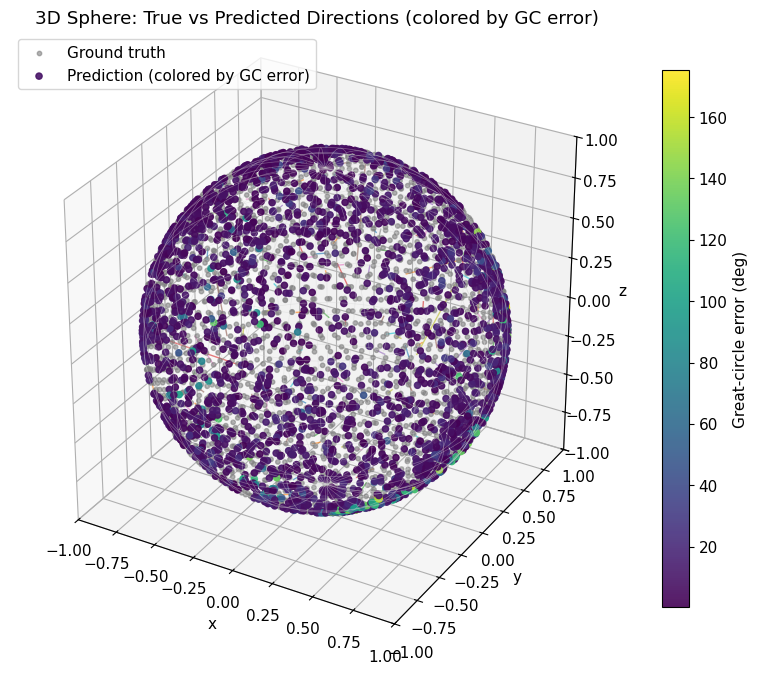

In [ ]:
# ============================================================
# Extra Analysis 3: 3D sphere visualization of localization
# ============================================================

import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 (needed for 3D projection)

# Convert GT and predictions to 3D unit vectors
V_true = sph_to_vec_deg(G_val[:, 0], G_val[:, 1]).astype(np.float32)  # (N, 3)
V_pred = sph_to_vec_deg(P_val[:, 0], P_val[:, 1]).astype(np.float32)  # (N, 3)

# Great-circle error per sample (deg)
gc_err = great_circle_err_deg(P_val, G_val).astype(np.float32)

# Unit sphere mesh (context)
theta = np.linspace(0, 2 * np.pi, 80)
phi   = np.linspace(0, np.pi, 40)
theta, phi = np.meshgrid(theta, phi)

xs = np.sin(phi) * np.cos(theta)
ys = np.sin(phi) * np.sin(theta)
zs = np.cos(phi)

fig = plt.figure(figsize=(8, 8))
ax = fig.add_subplot(111, projection="3d")

# Light wireframe sphere
ax.plot_wireframe(
    xs, ys, zs,
    rstride=3, cstride=3,
    color="lightgray", alpha=0.4, linewidth=0.5
)

# Ground-truth directions
ax.scatter(
    V_true[:, 0], V_true[:, 1], V_true[:, 2],
    s=10, c="gray", alpha=0.6, label="Ground truth"
)

# Predicted directions, colored by error
p = ax.scatter(
    V_pred[:, 0], V_pred[:, 1], V_pred[:, 2],
    s=20, c=gc_err, cmap="viridis", alpha=0.9,
    label="Prediction (colored by GC error)"
)

# Optional: short error vectors (GT -> Pred) every 10th sample
DRAW_ARROWS = True
if DRAW_ARROWS:
    scale = 0.3
    for vt, vp in zip(V_true[::10], V_pred[::10]):
        ax.plot(
            [vt[0], vt[0] + (vp[0] - vt[0]) * scale],
            [vt[1], vt[1] + (vp[1] - vt[1]) * scale],
            [vt[2], vt[2] + (vp[2] - vt[2]) * scale],
            alpha=0.6,
            linewidth=1.0,
        )

# Pretty axes
ax.set_box_aspect([1, 1, 1])
ax.set_xlim([-1, 1])
ax.set_ylim([-1, 1])
ax.set_zlim([-1, 1])

ax.set_xlabel("x")
ax.set_ylabel("y")
ax.set_zlabel("z")
ax.set_title("3D Sphere: True vs Predicted Directions (colored by GC error)")

# Colorbar
cb = fig.colorbar(p, ax=ax, shrink=0.7)
cb.set_label("Great-circle error (deg)")

ax.legend(loc="upper left")
plt.tight_layout()
plt.show()


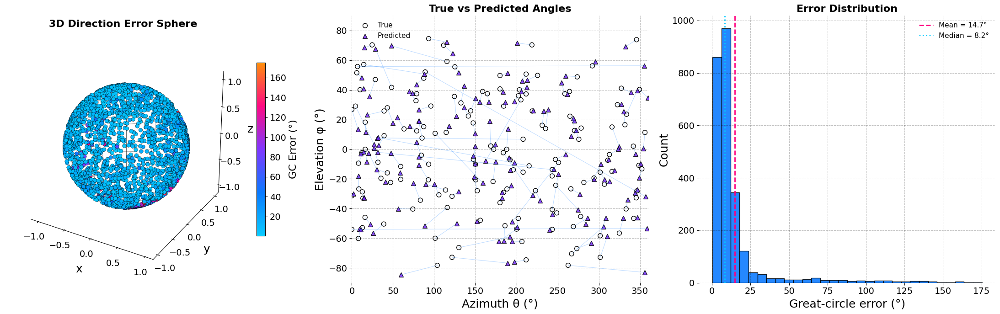

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401

# Waveform-inspired gradient (cyan → blue → purple → pink → orange)
wave_colors = ["#00C9FF", "#0074FF", "#7B2FFF", "#FF007E", "#FF8A00"]
wave_cmap = LinearSegmentedColormap.from_list("wave_cmap", wave_colors)

plt.rcParams.update({
    "font.family": "sans-serif",
    "font.size": 11,
})

# --- IMPORTANT: use predicted elevation from P_val
V_true = sph_to_vec_deg(G_val[:, 0], G_val[:, 1])
V_pred = sph_to_vec_deg(P_val[:, 0], P_val[:, 1])   # <-- FIXED
gc_err = great_circle_err_deg(P_val, G_val)

fig = plt.figure(figsize=(22, 7), facecolor="none")

# ========================= 1 — 3D GLOBE =========================
ax1 = fig.add_subplot(1, 3, 1, projection="3d", facecolor="none")

# Sphere guide lines
for p in np.linspace(-75, 75, 7):
    ph = np.deg2rad(90 - p)
    th = np.linspace(0, 2 * np.pi, 250)
    ax1.plot(
        np.sin(ph) * np.cos(th),
        np.sin(ph) * np.sin(th),
        np.cos(ph),
        color="black",
        alpha=0.35,
        linewidth=0.8
    )

for t in np.linspace(0, 330, 12):
    th = np.deg2rad(t)
    ph = np.linspace(0, np.pi, 250)
    ax1.plot(
        np.sin(ph) * np.cos(th),
        np.sin(ph) * np.sin(th),
        np.cos(ph),
        color="black",
        alpha=0.35,
        linewidth=0.8
    )

p1 = ax1.scatter(
    V_pred[:, 0], V_pred[:, 1], V_pred[:, 2],
    c=gc_err, cmap=wave_cmap, s=38,
    edgecolor="black", linewidth=0.35, alpha=0.96
)

ax1.set_box_aspect([1, 1, 1])
ax1.set_title("3D Direction Error Sphere", color="black", fontsize=16, fontweight="bold")

# Larger axis labels + ticks
ax1.set_xlabel("x", color="black", fontsize=18, labelpad=10)
ax1.set_ylabel("y", color="black", fontsize=18, labelpad=10)
ax1.set_zlabel("z", color="black", fontsize=18, labelpad=10)
ax1.tick_params(axis="both", labelsize=14)
ax1.zaxis.set_tick_params(labelsize=14)

ax1.grid(False)
for axis in (ax1.xaxis, ax1.yaxis, ax1.zaxis):
    axis.pane.set_visible(False)

cb = fig.colorbar(p1, ax=ax1, shrink=0.65, pad=0.05)
cb.set_label("GC Error (°)", color="black", fontsize=16)
cb.ax.tick_params(labelsize=14, colors="black")

# ====================== 2 — SCATTER PLOT =========================
ax2 = fig.add_subplot(1, 3, 2, facecolor="none")

rng = np.random.default_rng(0)
sel = rng.choice(len(G_val), min(150, len(G_val)), replace=False)

az_true = (G_val[sel, 0] % 360.0).astype(np.float32)
el_true = G_val[sel, 1].astype(np.float32)
az_pred = (P_val[sel, 0] % 360.0).astype(np.float32)
el_pred = P_val[sel, 1].astype(np.float32)

ax2.scatter(az_true, el_true, s=50, facecolor="none", edgecolor="black", label="True")
ax2.scatter(
    az_pred, el_pred,
    s=50, facecolor=wave_colors[2], edgecolor="black",
    marker="^", alpha=0.85, label="Predicted"
)

for x0, y0, x1, y1 in zip(az_true, el_true, az_pred, el_pred):
    ax2.plot([x0, x1], [y0, y1], color=wave_colors[1], alpha=0.25, linewidth=0.8)

ax2.set_title("True vs Predicted Angles", color="black", fontsize=16, fontweight="bold")

# Larger axis labels + ticks
ax2.set_xlabel("Azimuth θ (°)", color="black", fontsize=18)
ax2.set_ylabel("Elevation φ (°)", color="black", fontsize=18)
ax2.tick_params(axis="both", labelsize=14)

ax2.set_xlim(0, 360)
ax2.set_ylim(-90, 90)

ax2.grid(True, color="black", alpha=0.25, linestyle="--")
for s in ax2.spines.values():
    s.set_visible(False)

leg = ax2.legend(frameon=False)
for t in leg.get_texts():
    t.set_color("black")

# ====================== 3 — HISTOGRAM =========================
ax3 = fig.add_subplot(1, 3, 3, facecolor="none")

gc_mean, gc_med = float(np.mean(gc_err)), float(np.median(gc_err))

ax3.hist(gc_err, bins=30, color=wave_colors[1], edgecolor="black", alpha=0.85)
ax3.axvline(gc_mean, color=wave_colors[3], linestyle="--", linewidth=2,
            label=f"Mean = {gc_mean:.1f}°")
ax3.axvline(gc_med, color=wave_colors[0], linestyle=":", linewidth=2,
            label=f"Median = {gc_med:.1f}°")

ax3.set_title("Error Distribution", color="black", fontsize=16, fontweight="bold")

# Larger axis labels + ticks
ax3.set_xlabel("Great-circle error (°)", color="black", fontsize=18)
ax3.set_ylabel("Count", color="black", fontsize=18)
ax3.tick_params(axis="both", labelsize=14)

ax3.grid(True, color="black", alpha=0.25, linestyle="--")
for s in ax3.spines.values():
    s.set_visible(False)

leg = ax3.legend(frameon=False)
for t in leg.get_texts():
    t.set_color("black")

plt.tight_layout()
plt.savefig("RESULTS_THREEPANEL_EQUAL.png", dpi=500, transparent=True)
plt.show()
